In [ ]:
import numpy as np
from scipy.optimize import minimize_scalar
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import special_ortho_group as sp


# Градиентный спуск с постоянным шагом

In [ ]:
def gradient_descent_constant_step(start, gradient_func, step_size, max_iter, tol=0.01):
    steps = [start]
    x = start
    for i in range(max_iter):
        diff = step_size * gradient_func(x)
        if np.abs(diff).all() < tol:
            break
        x = x - diff
        steps.append(x)
    return steps, x, i+1

# Алгоритм спуска с дроблением шага, используя условие Армихо

In [ ]:
def armijo_line_search(f, grad, x, max_iter, alpha=1.0, gamma=0.5, c=0.1):
    g = grad(x)
    fx = f(x)
    iter_count = 0

    while iter_count < max_iter:
        new_x = x - alpha * g
        new_fx = f(new_x)

        if new_fx <= fx - c * alpha * np.linalg.norm(g) ** 2:
            return alpha

        alpha *= gamma
        iter_count += 1

    return alpha


def gradient_descent_armijo(f, grad, initial_x, max_iter, alpha=1.0, gamma=0.5, c=0.1, tol=1e-6):
    x = initial_x
    iter_count = 0
    x_history = [x]
    while iter_count < max_iter:
        g = grad(x)
        step_size = armijo_line_search(f, grad, x, max_iter, alpha, gamma, c)

        new_x = x - step_size * g
        if np.linalg.norm(new_x - x) < tol:
            break
        x = new_x
        iter_count += 1
        x_history.append(x)

    return x_history, x, iter_count



# Метод наискорейшего спуска с одномерной оптимизацией



In [ ]:
def fast_gradient_descent(x0, f, grad, alpha=0.1, beta=0.9, epsilon=1e-5, max_iter=1000):
    x = x0
    g = grad(x)
    iter_num = 0
    x_history = [x]
    while np.linalg.norm(g) > epsilon and iter_num < max_iter:
        t = minimize_scalar(lambda t: f(x - t*g), method='Brent')
        x = x - t.x*g
        g = grad(x)
        iter_num += 1
        x_history.append(x)
    return x, f(x), x_history, iter_num

# Метод сопряженных градиентов

In [ ]:
def conjugate_gradient(A, b, initial_x, max_iter, tol=1e-6):
    x = initial_x
    r = b - A @ x
    d = r
    iter_count = 0

    x_history = [x]

    while np.linalg.norm(r) > tol and iter_count < max_iter:
        q = A @ d
        alpha = np.dot(r, r) / np.dot(d, q)
        x = x + alpha * d
        r_new = r - alpha * q
        beta = np.dot(r_new, r_new) / np.dot(r, r)
        d = r_new + beta * d
        r = r_new
        iter_count += 1

        x_history.append(x)

    return x_history, iter_count

# 5. Работа с функциями


## Функция 1

In [ ]:
def f1(x):
  return 5*x[0]**2 + 2*x[1]**2

def grad_f1(x):
  return np.array([10*x[0], 4*x[1]])

A1 = np.array([[5, 0], [0, 2]])
b1 = np.zeros(2)
initial_x1 = [np.array([1, 1]), np.array([3, 2]), np.array([-2, -2])]

## Функция 2

In [ ]:

def f2(x):
    return x[0]**2 + 3*x[1]**2

def grad_f2(x):
    return np.array([2*x[0], 6*x[1]])

A2 = np.array([[1, 0], [0, 3]])
b2 = np.zeros(2)

initial_x2 = [np.array([1, 1]), np.array([3, 2]), np.array([-2, -2])]

## Метод для построения графиков

In [ ]:
x_values = np.linspace(-3, 3, 100)
y_values = np.linspace(-3, 3, 100)
X, Y = np.meshgrid(x_values, y_values)
Z1 = A1[0, 0] * X**2 + A1[1, 1] * Y**2 - b1[0] * X - b1[1] * Y
Z2 = A2[0, 0] * X**2 + A2[1, 1] * Y**2 - b2[0] * X - b2[1] * Y

def make_plot(initial, history, func_name):
    plt.figure(figsize=(10, 8), dpi=250)
    plt.contour(X, Y, Z1, levels=20, cmap='RdYlBu')
    plt.contourf(X, Y, Z1, levels=20, cmap='RdYlBu')
    plt.colorbar()
    plt.scatter(*initial, marker='x', color='red', s=100, label='Initial')
    plt.xlabel('X', fontsize=14)
    plt.ylabel('Y', fontsize=14)
    plt.title('Function: ' + func_name, fontsize=16)
    plt.legend()
    plt.grid(True)
    history = np.array(history)
    plt.plot(history[:, 0], history[:, 1], marker='o', color='black', markersize=8, label='Conjugate Gradient')
    levels = plt.contour(X, Y, Z1, levels=10, colors='black', linewidths=0.5, alpha=0.5)
    plt.clabel(levels, inline=True, fontsize=10, fmt='%1.d')
    plt.show()

# Первая функция
## Метод градиентного спуска с постоянным шагом

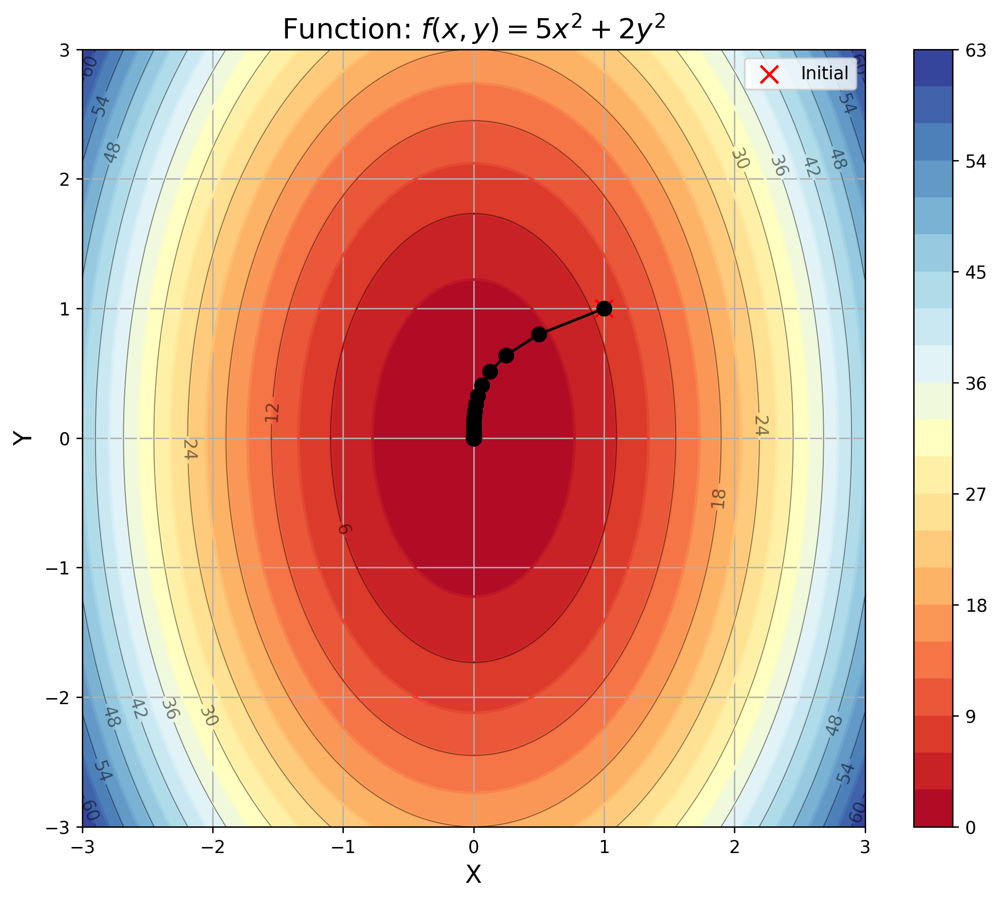

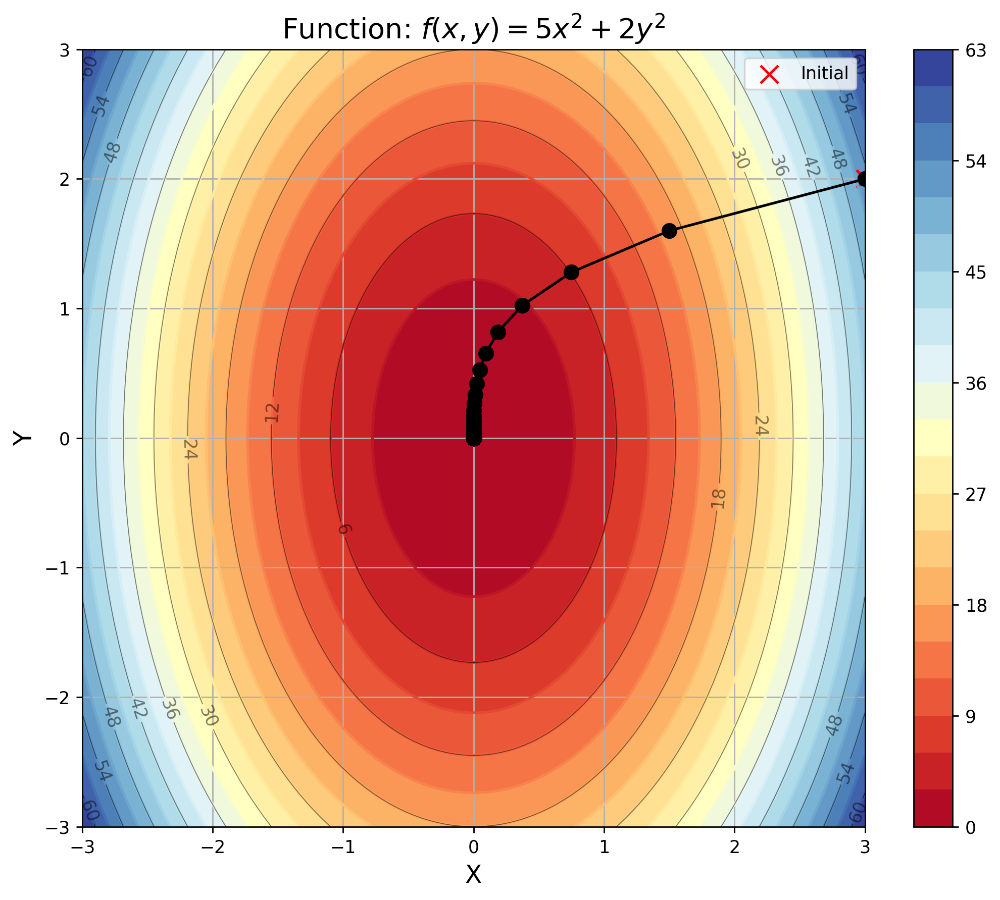

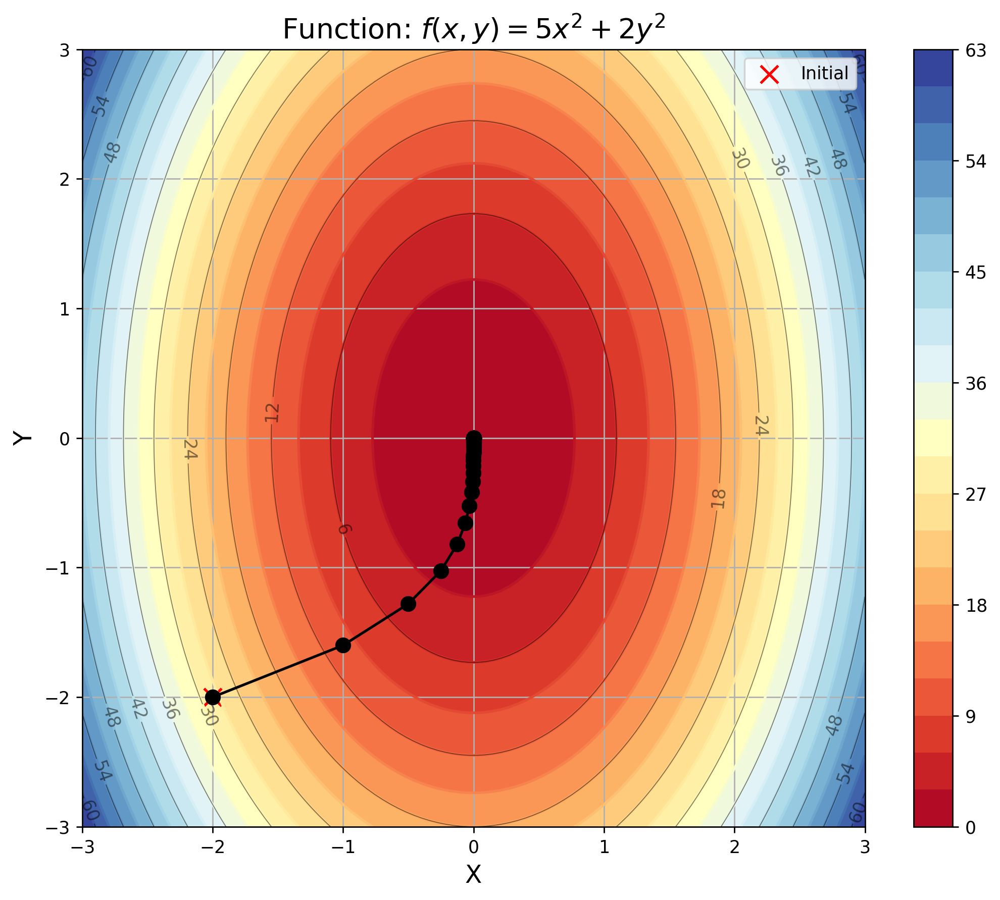

Number of iterations: 200
Number of iterations: 200
Number of iterations: 200


In [ ]:
x_history1, x, num_iter1 = gradient_descent_constant_step(initial_x1[0], grad_f1, 0.05, 200)
x_history2, x, num_iter2 = gradient_descent_constant_step(initial_x1[1], grad_f1, 0.05, 200)
x_history3, x, num_iter3 = gradient_descent_constant_step(initial_x1[2], grad_f1, 0.05, 200)
func_name1="$f(x, y) = 5x^2 + 2y^2$"
make_plot(initial_x1[0], x_history1, func_name1)
make_plot(initial_x1[1], x_history2, func_name1)
make_plot(initial_x1[2], x_history3, func_name1)
print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)

# Вторая функция
## Метод градиентного спуска с постоянным шагом

Number of iterations: 402 



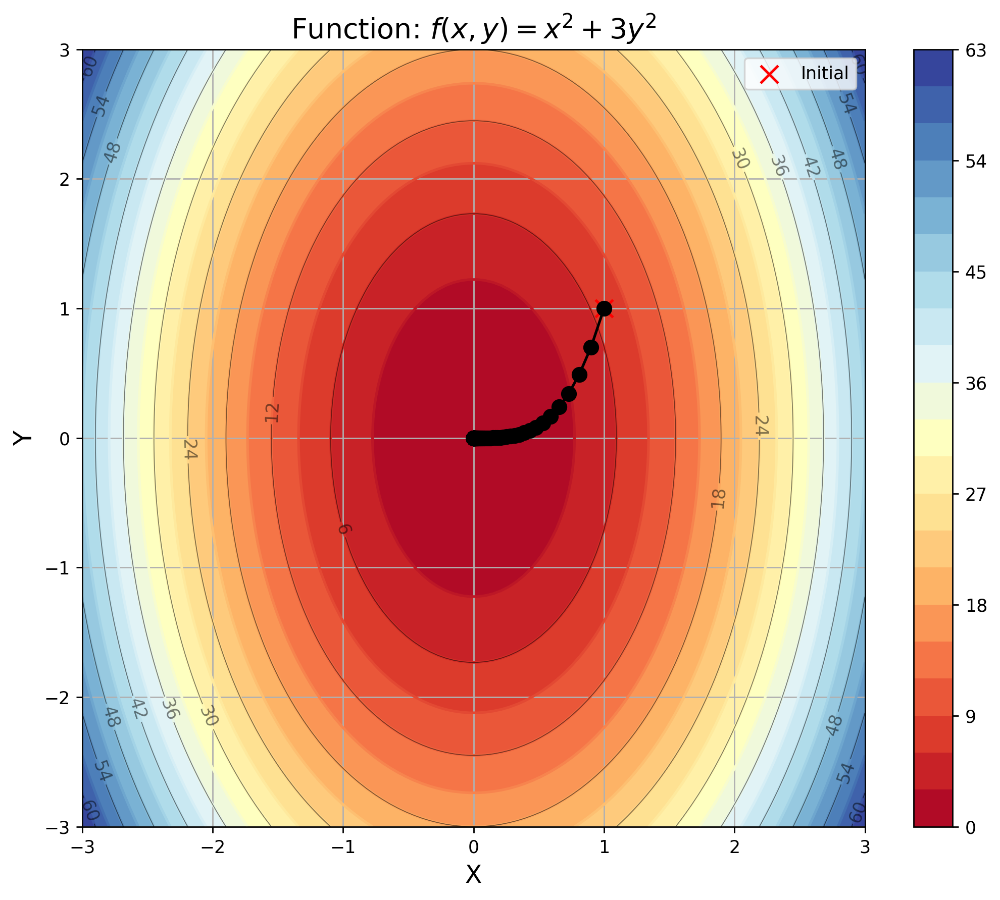

Number of iterations: 402 



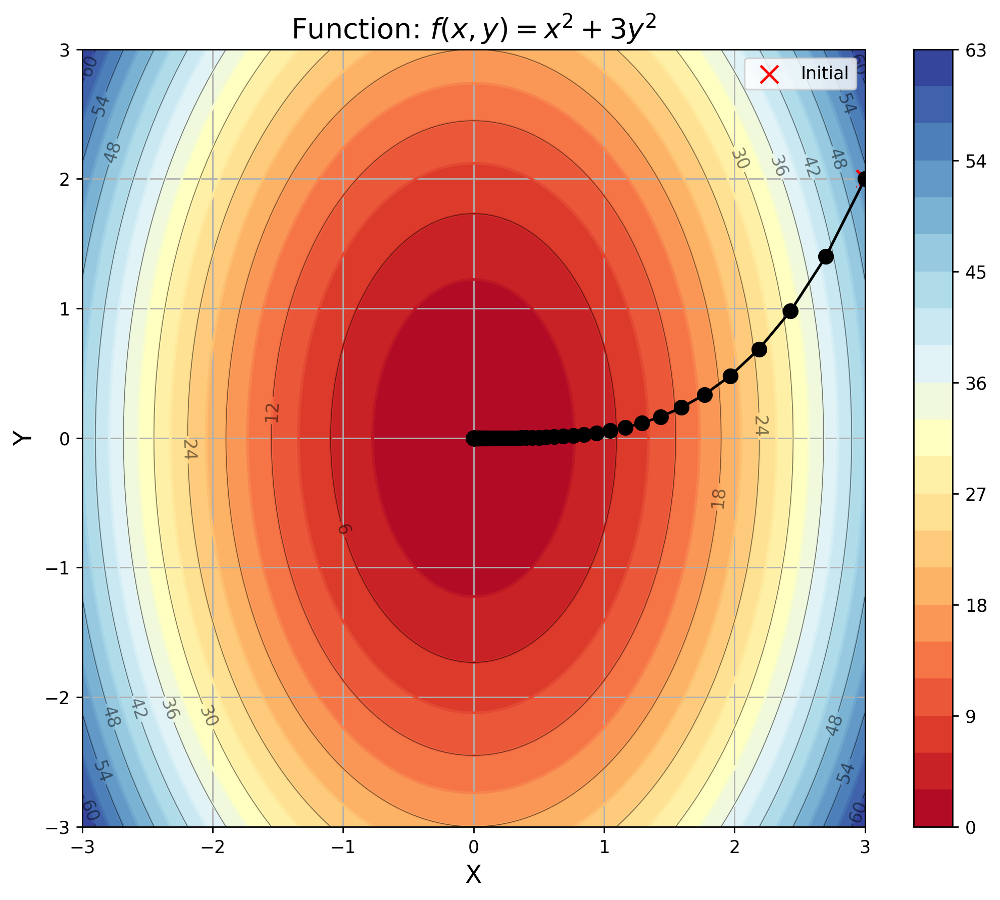

Number of iterations: 402 



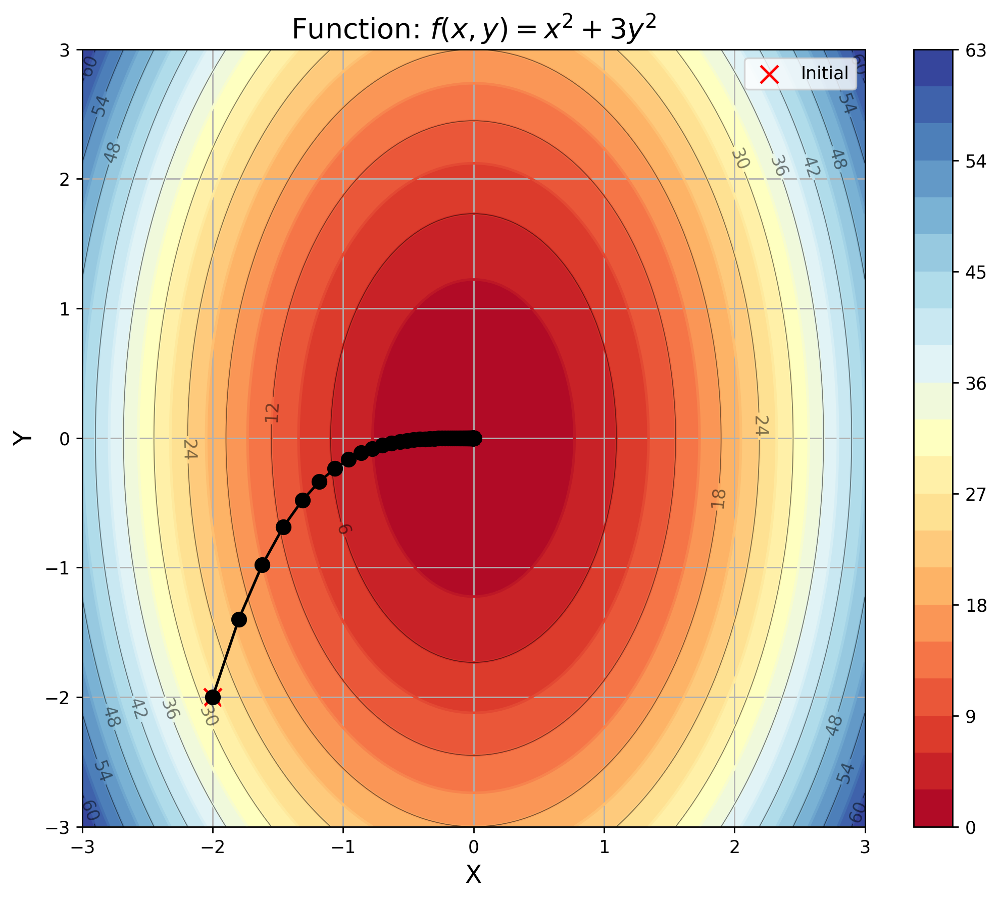

Number of iterations:  200
Number of iterations:  200
Number of iterations:  200


In [ ]:
x_history1, x, num_iter1 = gradient_descent_constant_step(initial_x2[0], grad_f2, 0.05, 200)
x_history2, x, num_iter2 = gradient_descent_constant_step(initial_x2[1], grad_f2, 0.05, 200)
x_history3, x, num_iter3 = gradient_descent_constant_step(initial_x2[2], grad_f2, 0.05, 200)
func_name2="$f(x, y) = x^2 + 3y^2$"

make_plot(initial_x2[0], x_history1, func_name2)
make_plot(initial_x2[1], x_history2, func_name2)
make_plot(initial_x2[2], x_history3, func_name2)
print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)

# Первая функция
## Алгоритм спуска с дроблением шага, используя условие Армихо

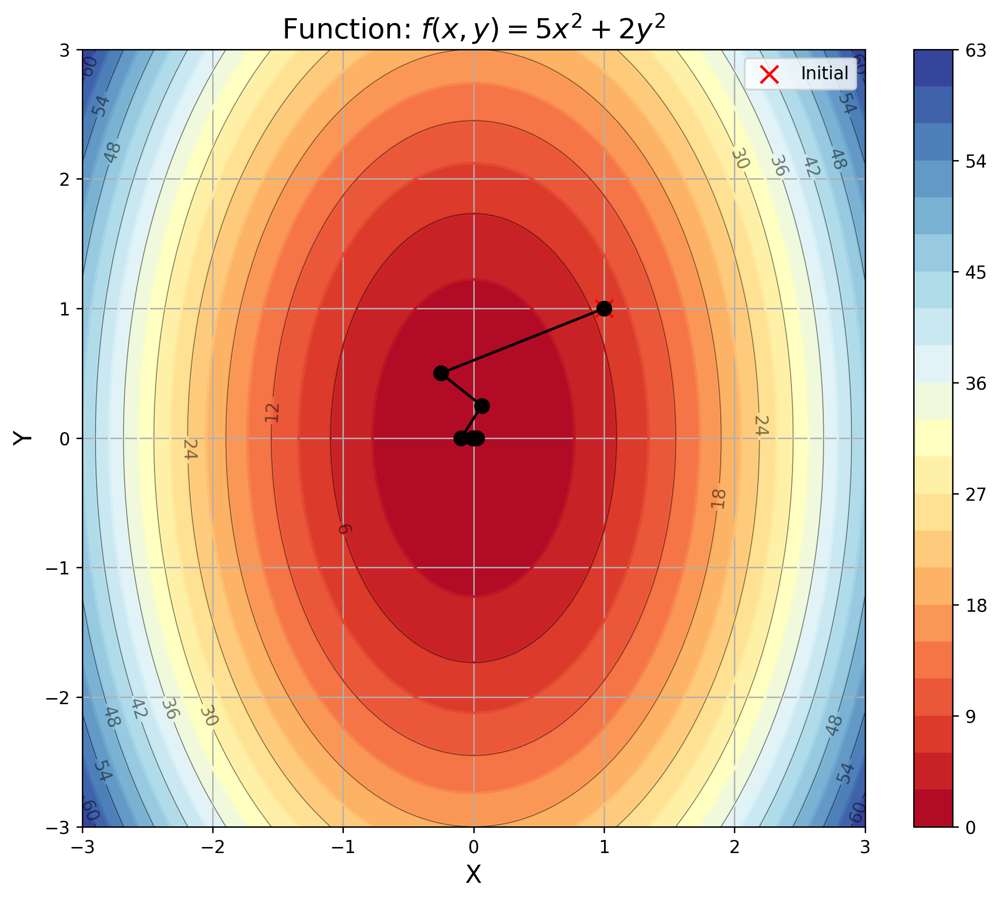

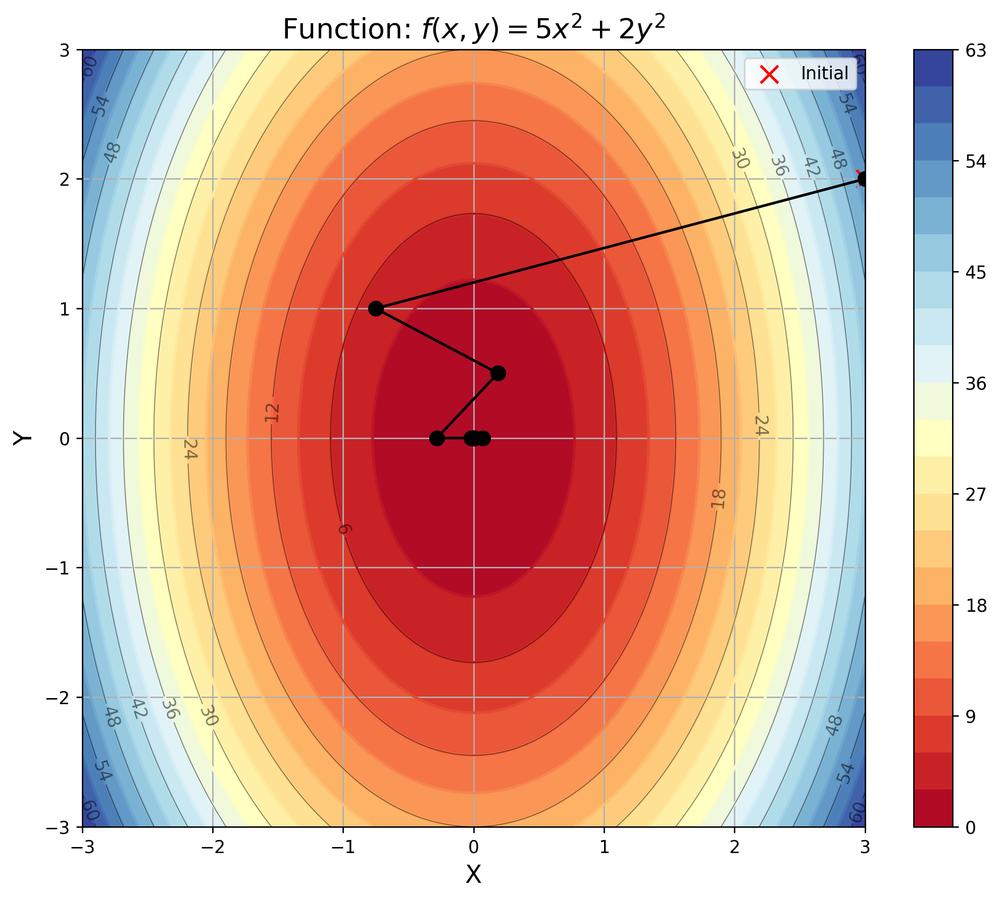

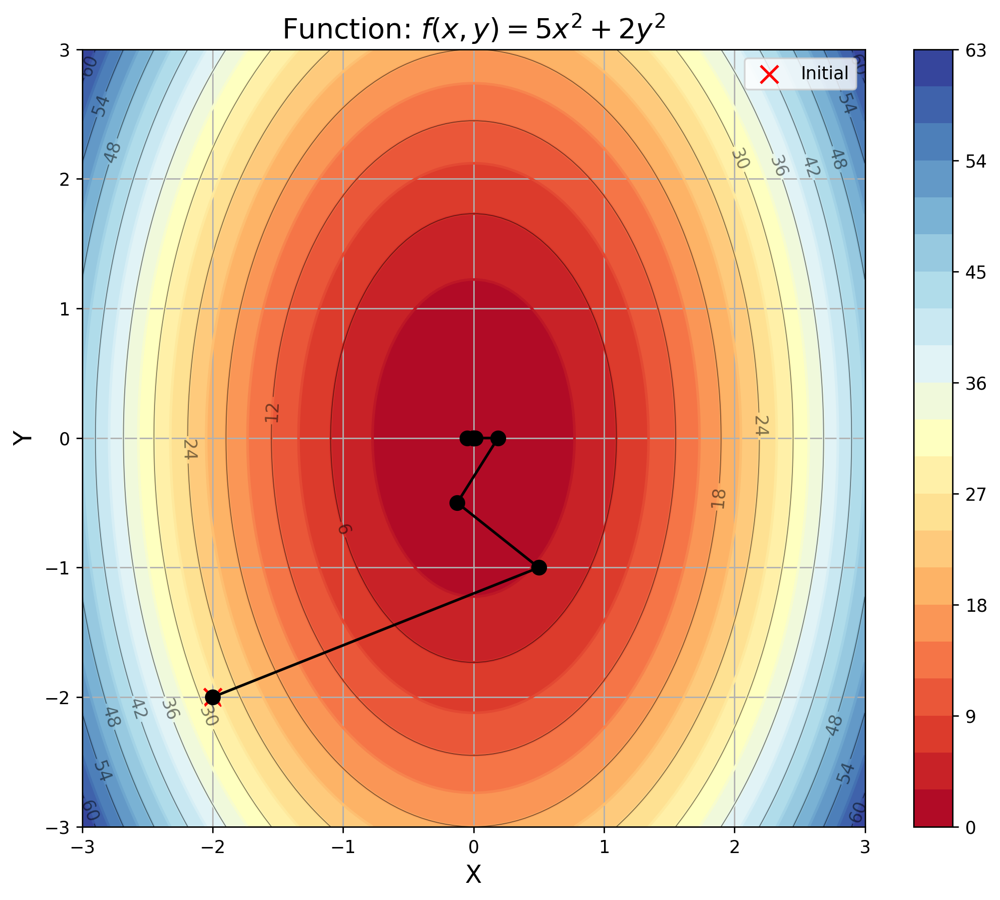

Number of iterations: 12
Number of iterations: 13
Number of iterations: 12


In [ ]:
x_history1, x, num_iter1 = gradient_descent_armijo(f1, grad_f1, initial_x1[0], 100)
x_history2, x, num_iter2 = gradient_descent_armijo(f1, grad_f1, initial_x1[1], 100)
x_history3, x, num_iter3 = gradient_descent_armijo(f1, grad_f1, initial_x1[2], 100)
func_name1="$f(x, y) = 5x^2 + 2y^2$"
make_plot(initial_x1[0], x_history1, func_name1)
make_plot(initial_x1[1], x_history2, func_name1)
make_plot(initial_x1[2], x_history3, func_name1)

print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)

# Вторая функция
## Алгоритм спуска с дроблением шага, используя условие Армихо

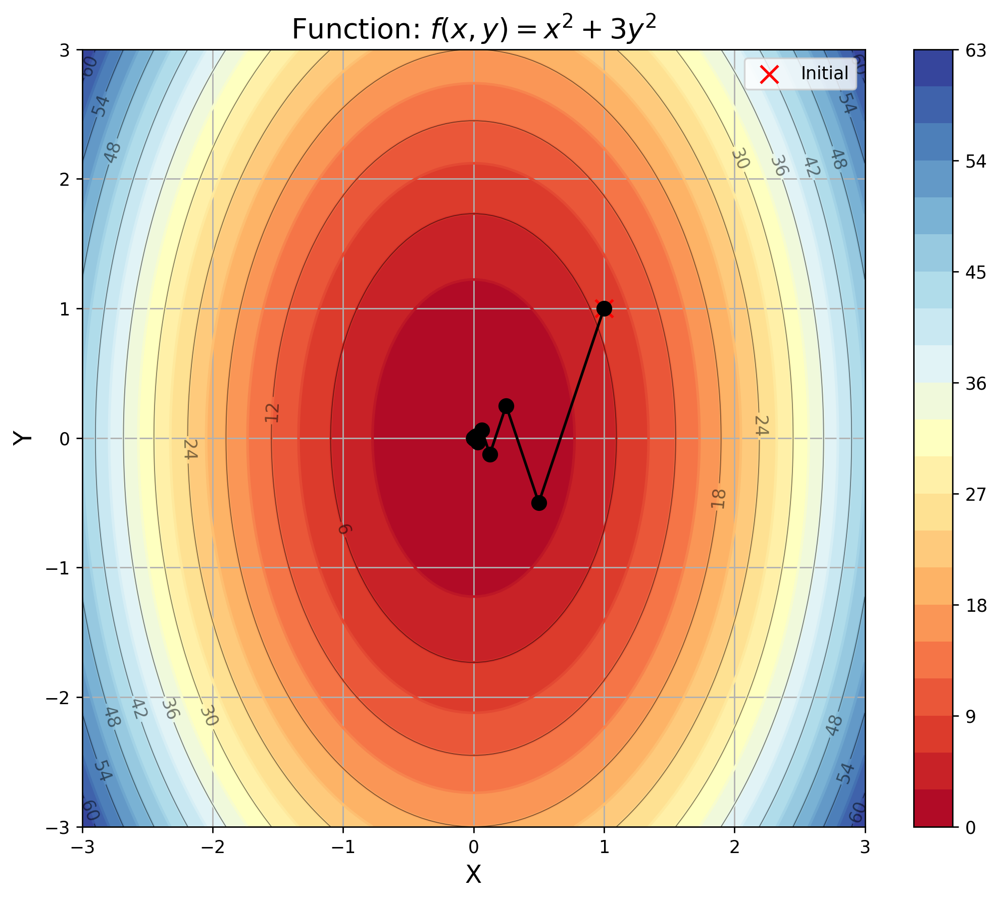

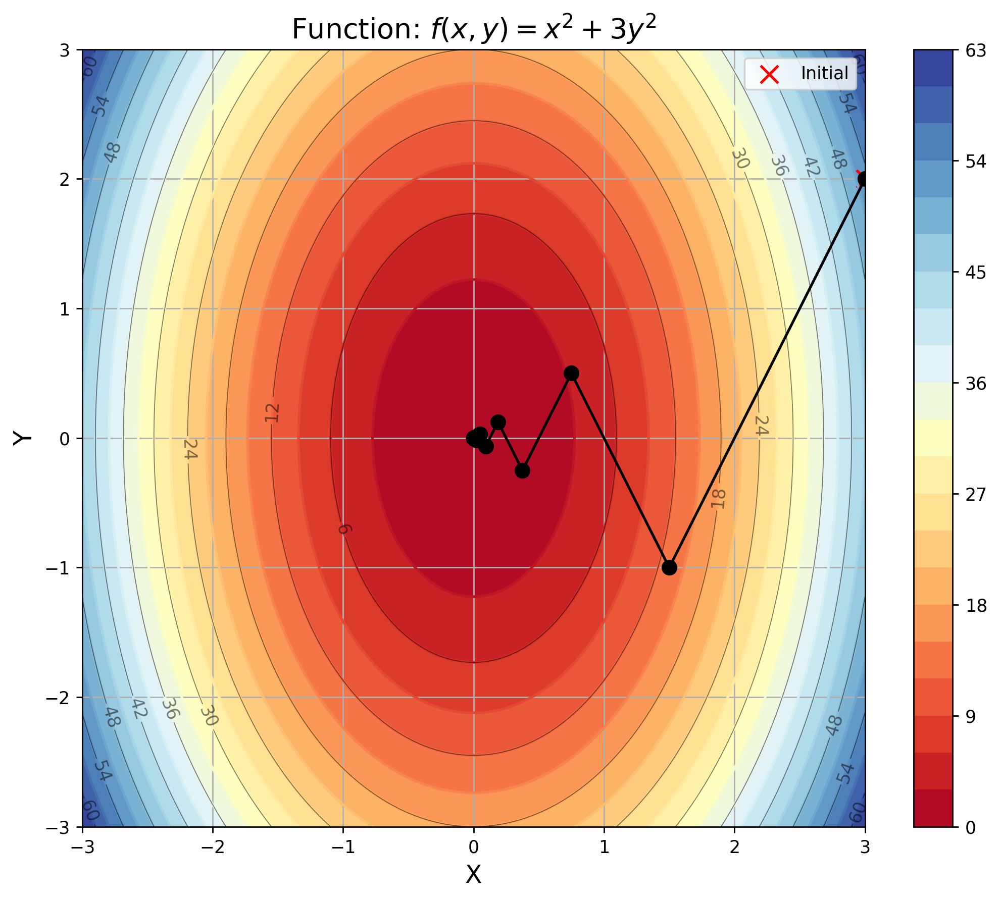

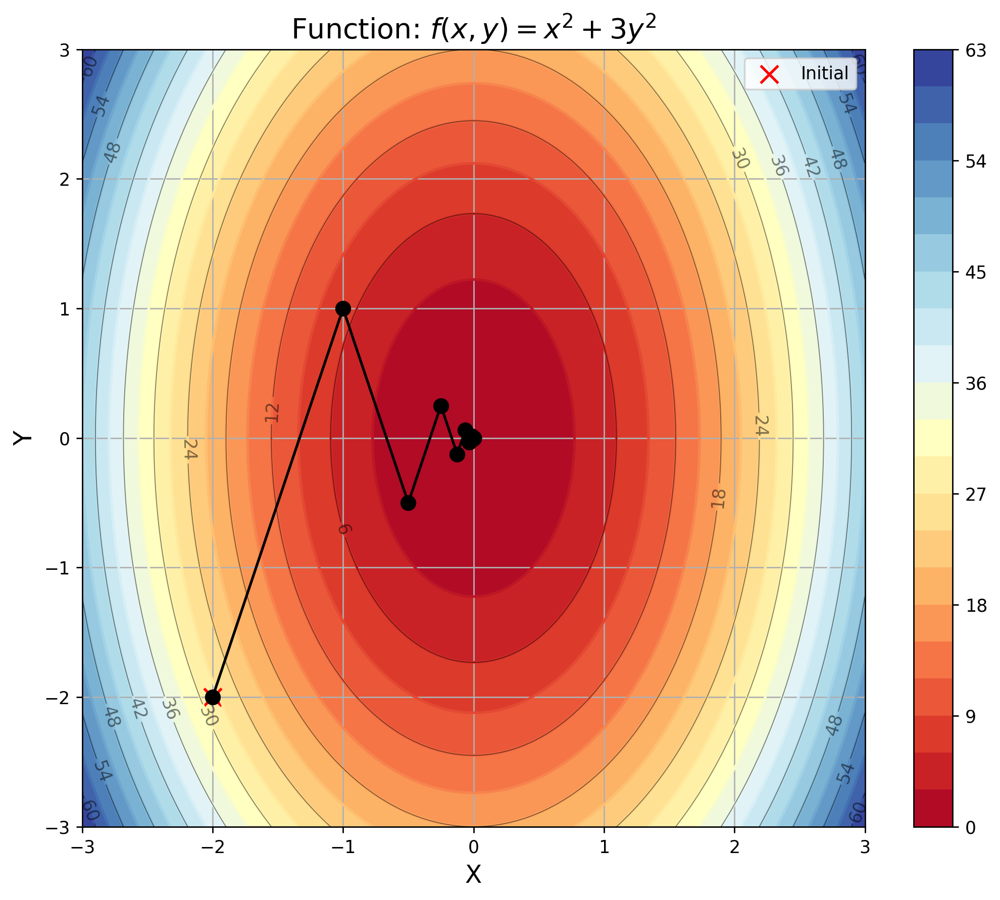

Number of iterations: 21
Number of iterations: 22
Number of iterations: 22


In [ ]:
x_history1, x, num_iter1 = gradient_descent_armijo(f2, grad_f2, initial_x2[0], 100)
x_history2, x, num_iter2 = gradient_descent_armijo(f2, grad_f2, initial_x2[1], 100)
x_history3, x, num_iter3 = gradient_descent_armijo(f2, grad_f2, initial_x2[2], 100)
func_name2="$f(x, y) = x^2 + 3y^2$"
make_plot(initial_x2[0], x_history1, func_name2)
make_plot(initial_x2[1], x_history2, func_name2)
make_plot(initial_x2[2], x_history3, func_name2)

print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)

# Первая функция
## Метод наискорейшего спуска с одномерной оптимизацией



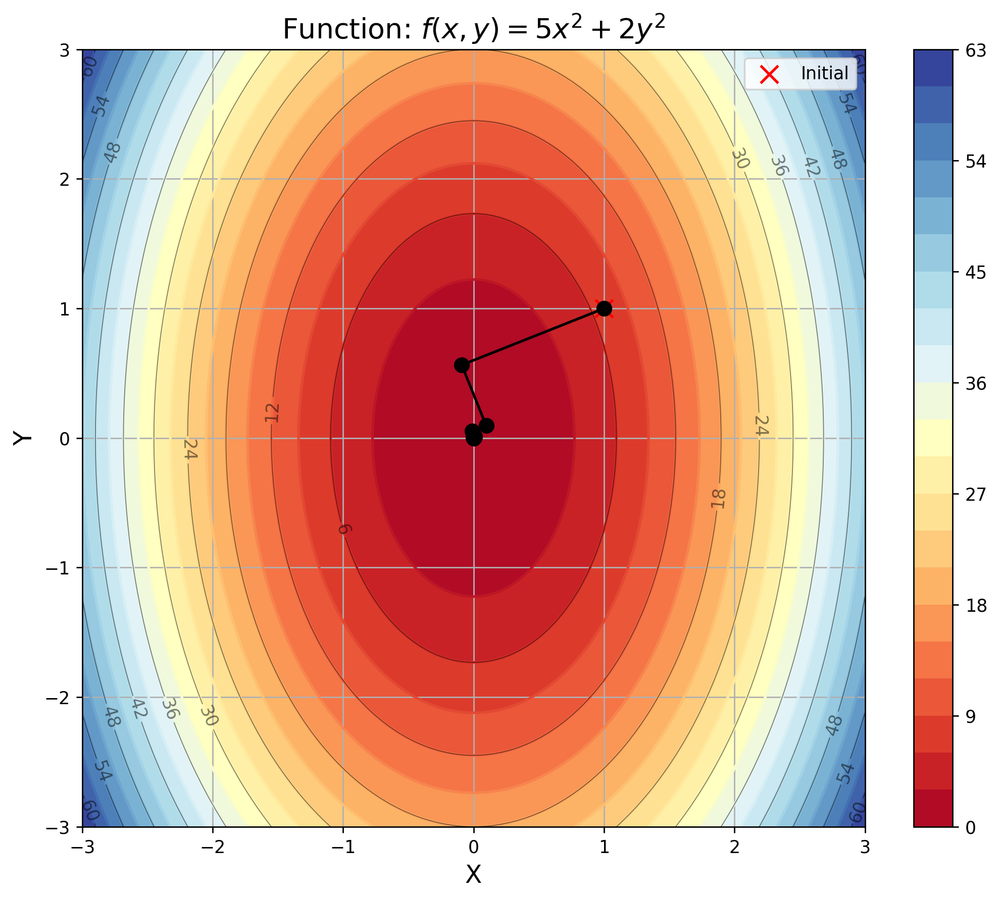

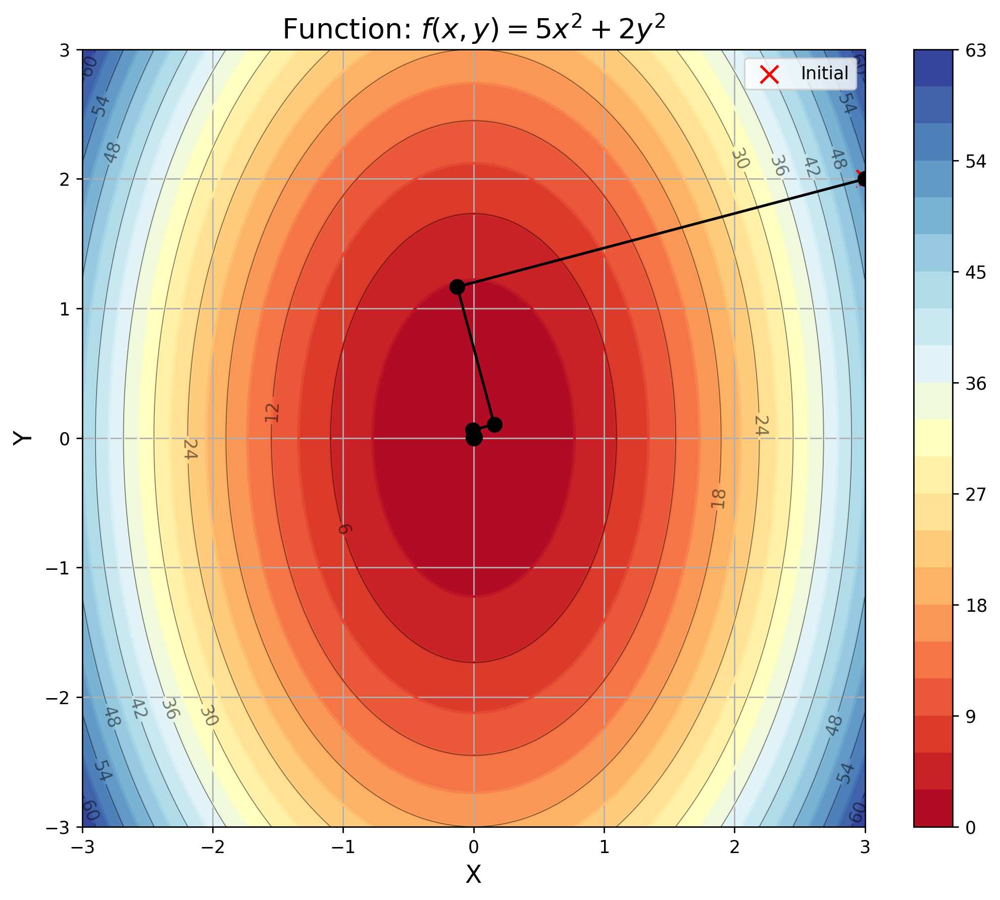

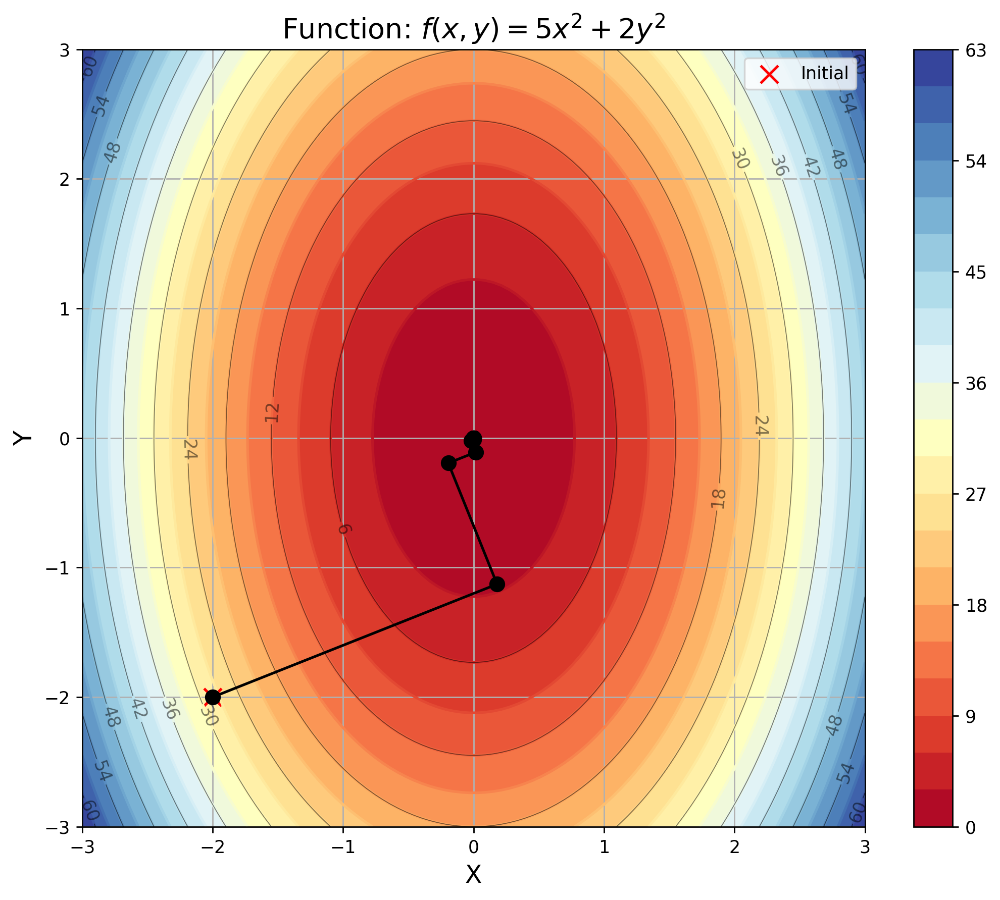

Number of iterations: 21
Number of iterations: 22
Number of iterations: 22


In [ ]:
x, f_x, x_history1, iter_num1 = fast_gradient_descent(initial_x1[0], f1, grad_f1)
x, f_x, x_history2, iter_num2 = fast_gradient_descent(initial_x1[1], f1, grad_f1)
x, f_x, x_history3, iter_num3 = fast_gradient_descent(initial_x1[2], f1, grad_f1)
func_name1="$f(x, y) = 5x^2 + 2y^2$"
make_plot(initial_x1[0], x_history1, func_name1)
make_plot(initial_x1[1], x_history2, func_name1)
make_plot(initial_x1[2], x_history3, func_name1)

print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)

# Вторая функция
## Метод наискорейшего спуска с одномерной оптимизацией



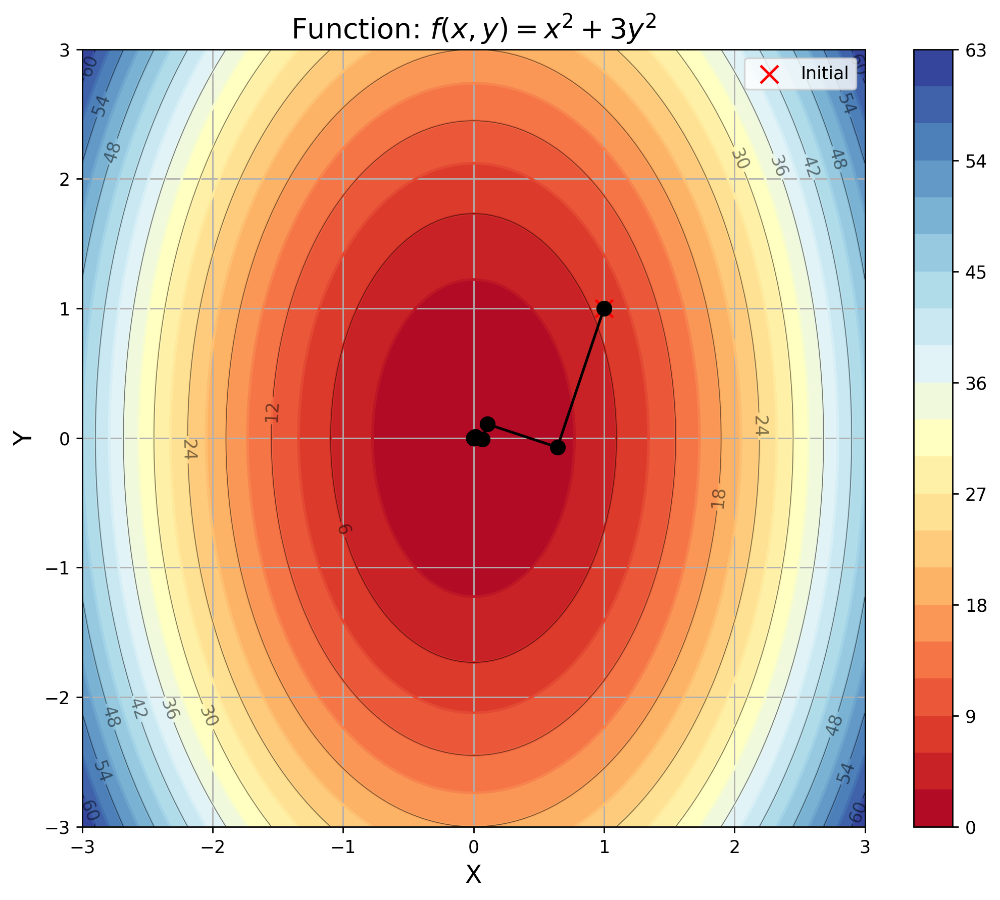

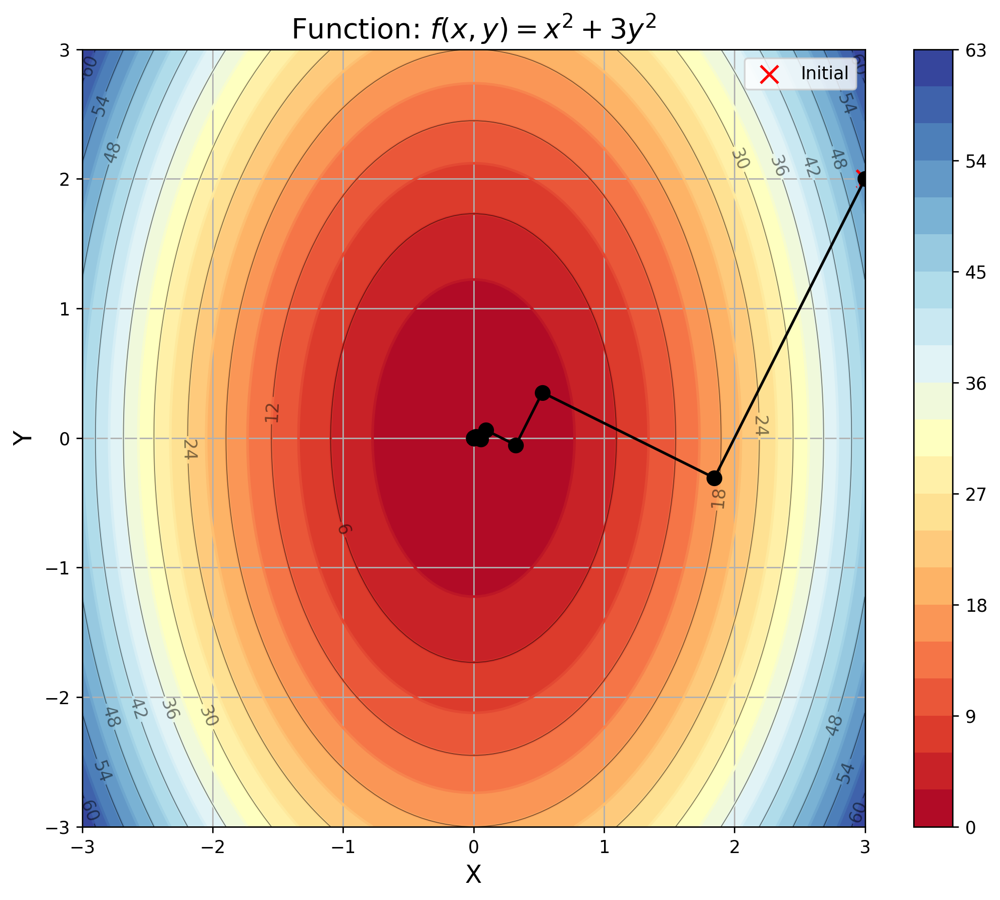

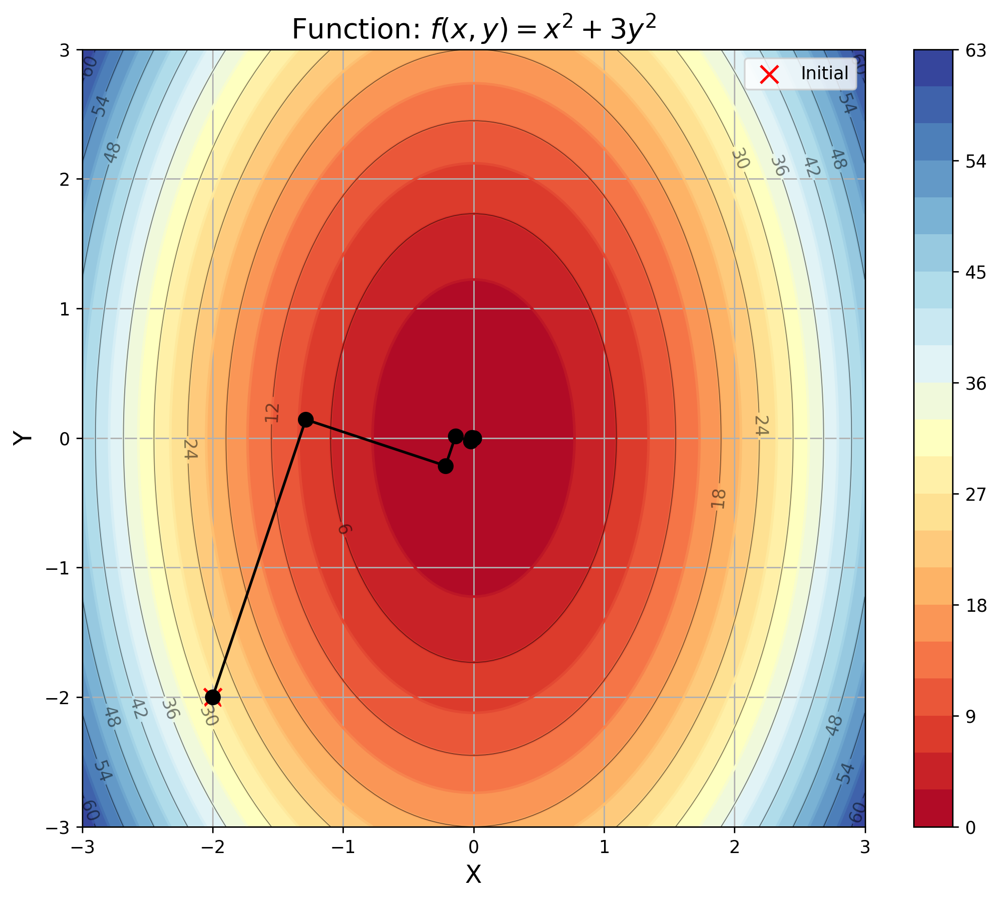

Number of iterations: 12
Number of iterations: 17
Number of iterations: 13


In [ ]:
x, f_x, x_history1, num_iter1 = fast_gradient_descent(initial_x2[0], f2, grad_f2)
x, f_x, x_history2, num_iter2 = fast_gradient_descent(initial_x2[1], f2, grad_f2)
x, f_x, x_history3, num_iter3 = fast_gradient_descent(initial_x2[2], f2, grad_f2)
func_name2="$f(x, y) = x^2 + 3y^2$"
make_plot(initial_x1[0], x_history1, func_name2)
make_plot(initial_x1[1], x_history2, func_name2)
make_plot(initial_x1[2], x_history3, func_name2)

print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)

# Первая функция
## Метод сопряженных градиентов



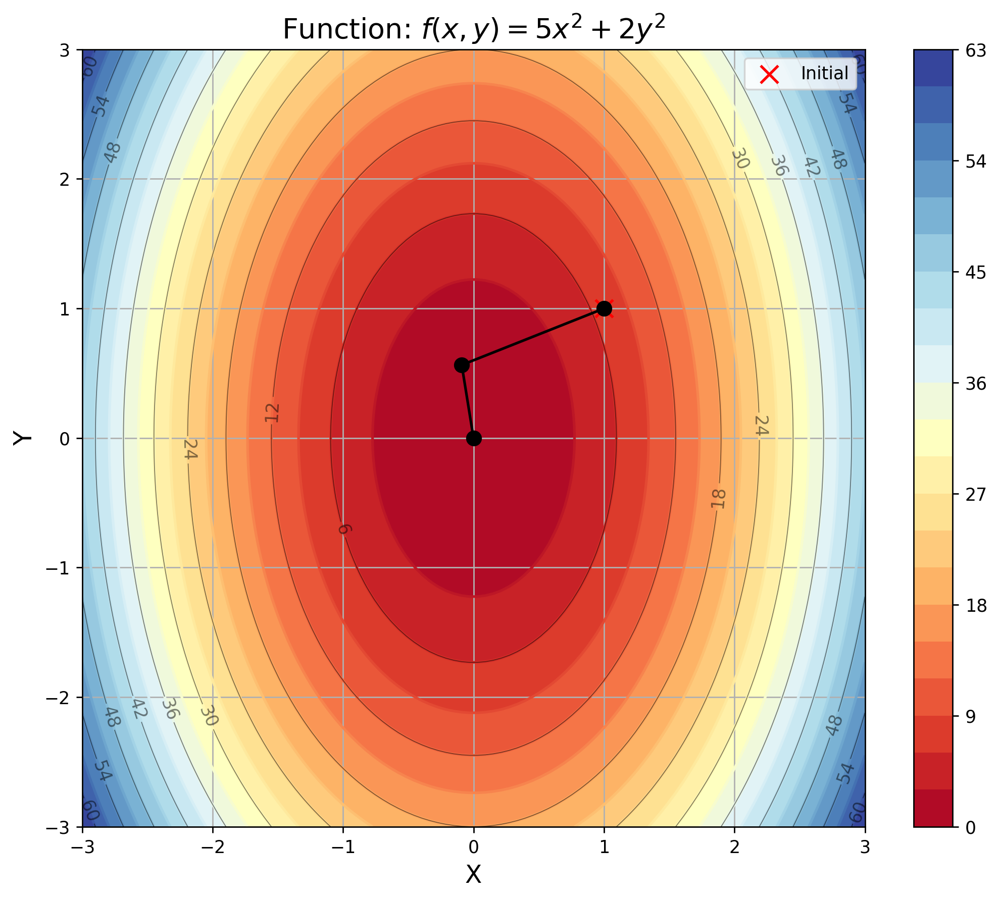

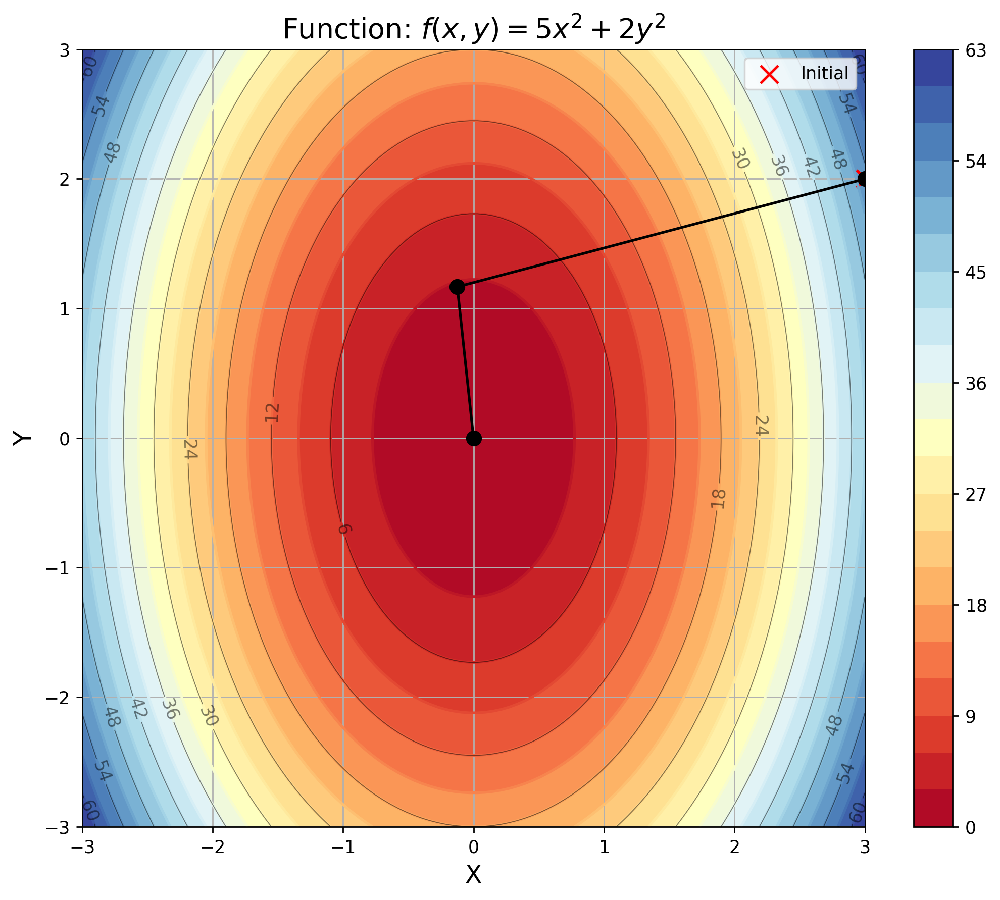

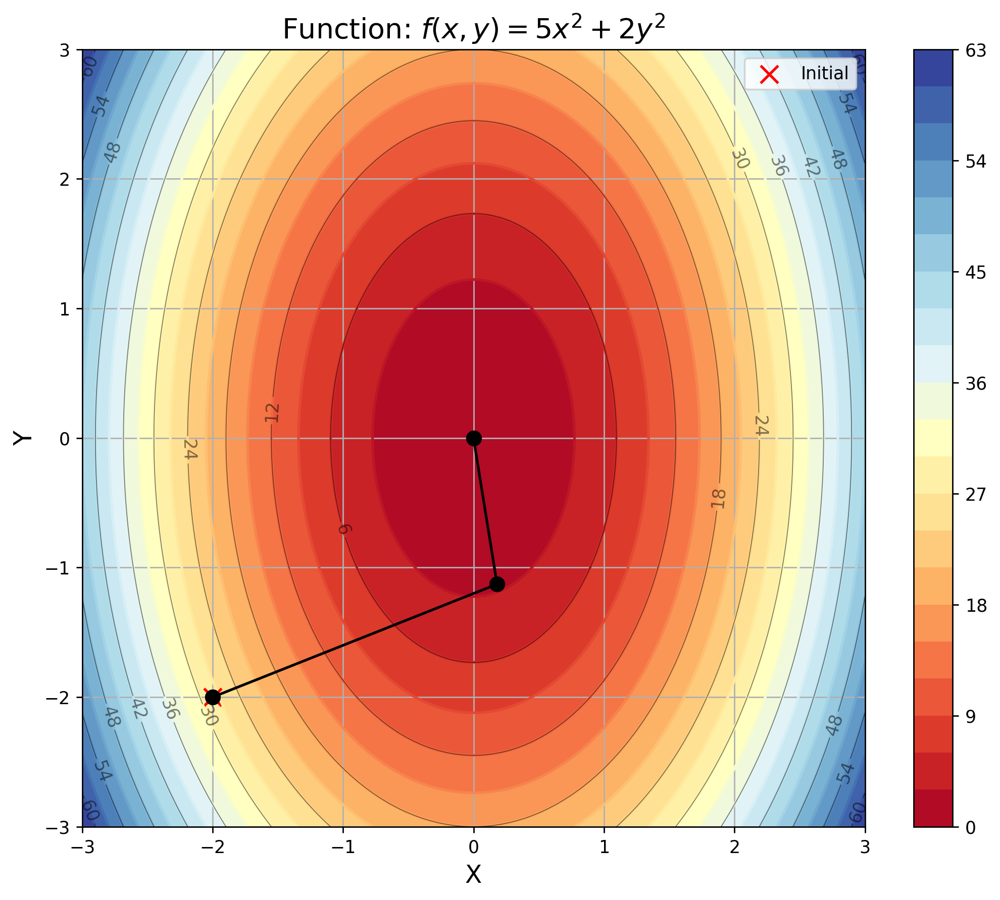

Number of iterations: 2
Number of iterations: 2
Number of iterations: 2


In [ ]:
x_history1, num_iter1 = conjugate_gradient(A1, b1, initial_x1[0], 100)
x_history2, num_iter2 = conjugate_gradient(A1, b1, initial_x1[1], 100)
x_history3, num_iter3 = conjugate_gradient(A1, b1, initial_x1[2], 100)
func_name1="$f(x, y) = 5x^2 + 2y^2$"
make_plot(initial_x1[0], x_history1, func_name1)
make_plot(initial_x1[1], x_history2, func_name1)
make_plot(initial_x1[2], x_history3, func_name1)

print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)

# Вторая функция
## Метод сопряженных градиентов



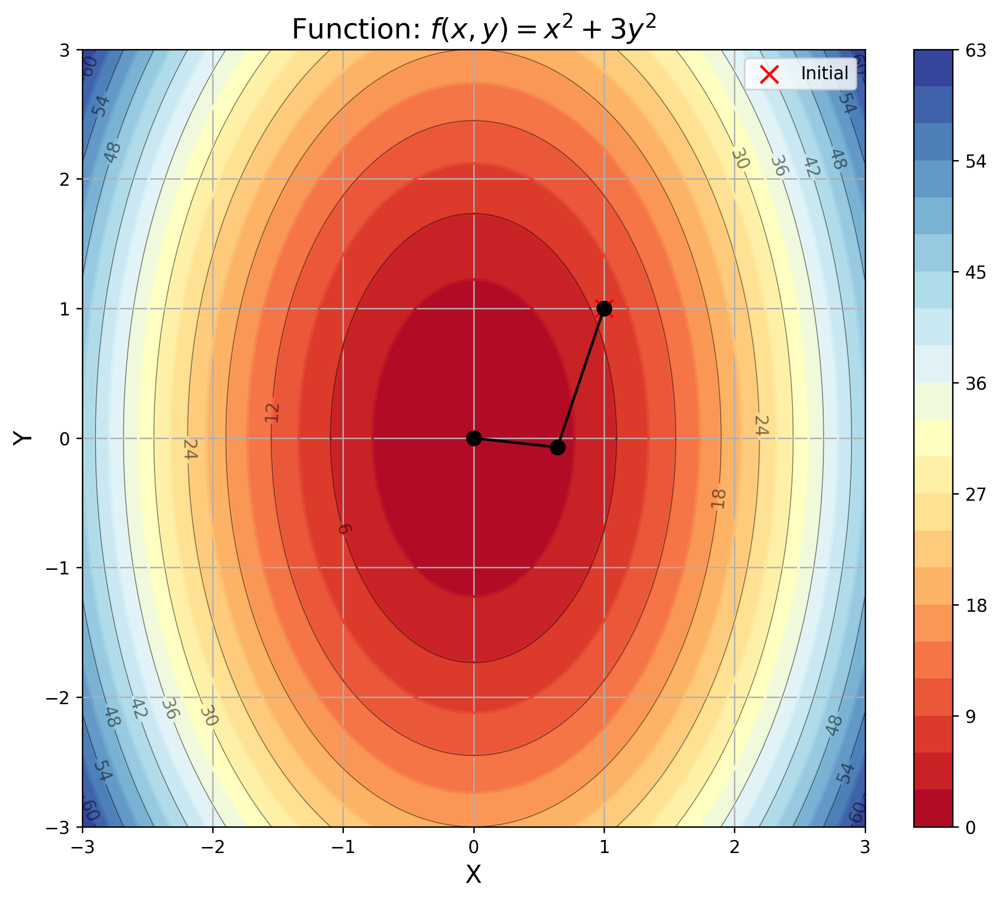

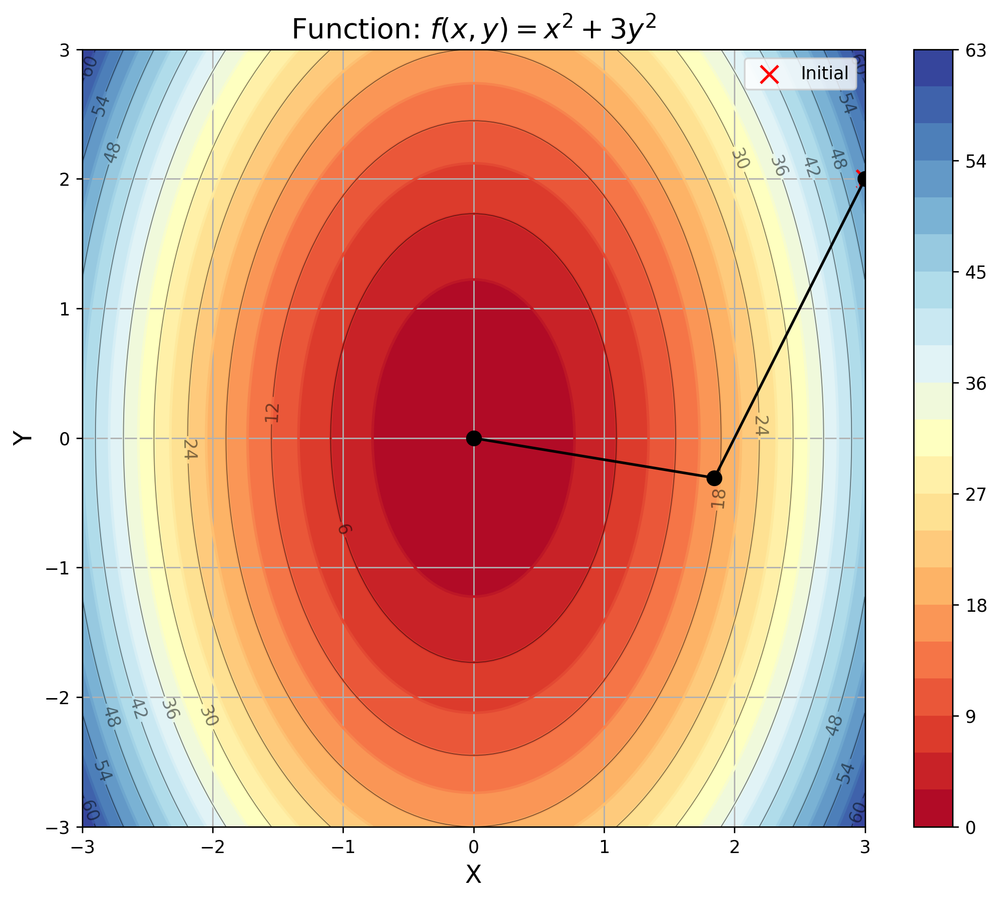

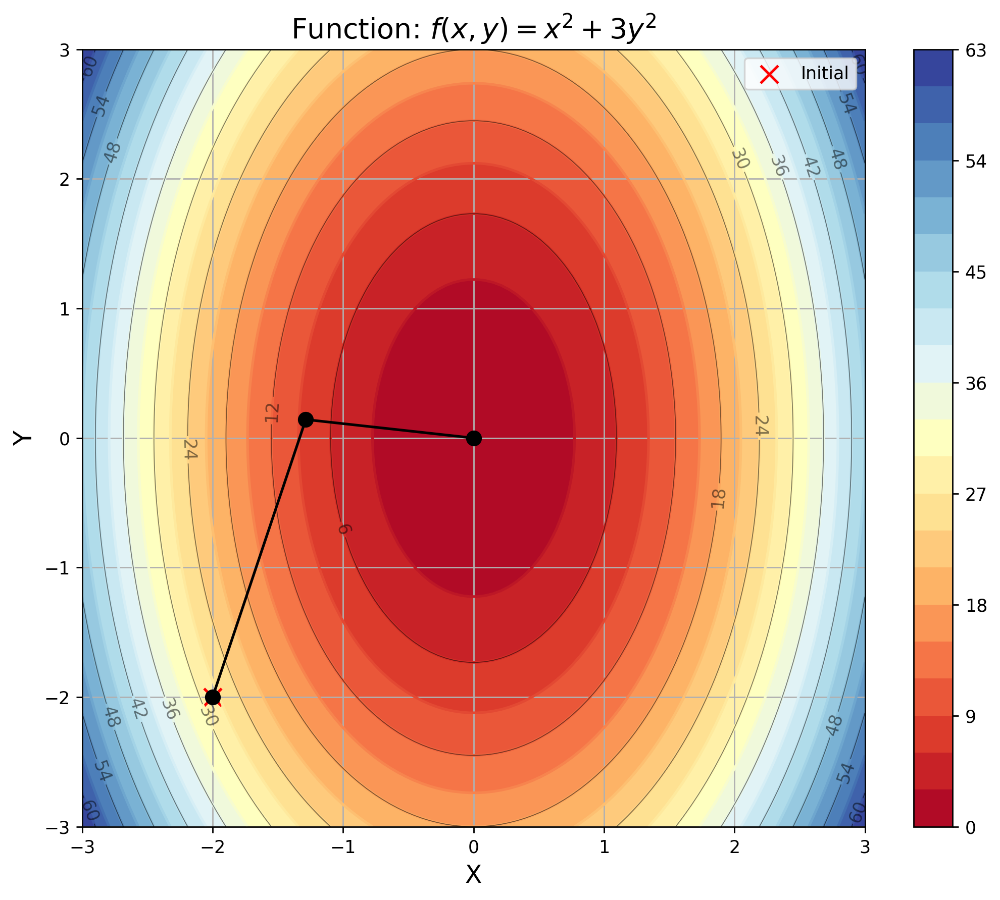

Number of iterations: 2
Number of iterations: 2
Number of iterations: 2


In [ ]:
x_history1, num_iter1 = conjugate_gradient(A2, b2, initial_x2[0], 100)
x_history2, num_iter2 = conjugate_gradient(A2, b2, initial_x2[1], 100)
x_history3, num_iter3 = conjugate_gradient(A2, b2, initial_x2[2], 100)
func_name2="$f(x, y) = x^2 + 3y^2$"
make_plot(initial_x2[0], x_history1, func_name2)
make_plot(initial_x2[1], x_history2, func_name2)
make_plot(initial_x2[2], x_history3, func_name2)

print("Number of iterations:", num_iter1)
print("Number of iterations:", num_iter2)
print("Number of iterations:", num_iter3)


# 6 - Анализ функций

# Генератор случайных квадратичных функций п переменных с числом обусловленности К

In [ ]:
def random_quadratic_function(n, k):
    if k == 0:
        return lambda x: 0, lambda x: np.zeros((n, 1))
    interval = [1, k] if k > 0 else [k, -1]
    a = np.random.uniform(*interval, n)
    b = np.zeros(n)
    a_max = np.argmax(a)
    a_min = np.argmin(a)
    a[a_max] = a[a_min] * k
    A = np.diag(a)
    b = np.random.randn(n, 1)
    c = np.random.randn()
    f = lambda x: 0.5 * x.T @ A @ x + b.T @ x + c
    # df = lambda x: A @ x + b
    return f

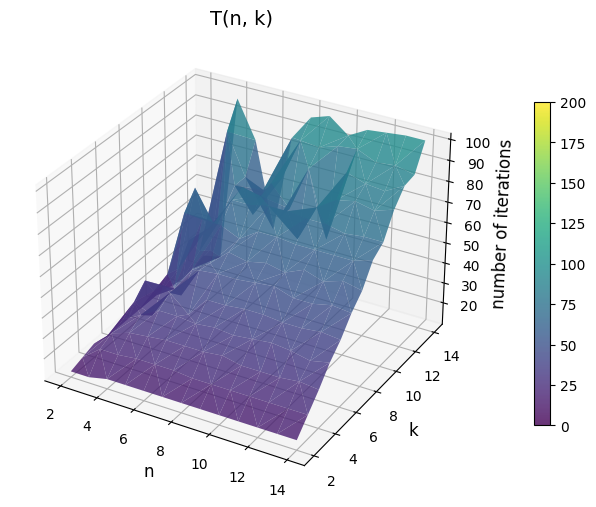

In [ ]:
import autograd.numpy as np
from autograd import grad
import matplotlib.pyplot as plt

initial_point = np.array([10, 10])
n_arr = []
k_arr = []
iter_arr = []
for n in range(2, 15):
    for k in range(2, 15):
        f = random_quadratic_function(n, k)
        grad_f = grad(f)
        initial_point = np.full(n, 5)
        x, f_x, x_history, iter_num = fast_gradient_descent(initial_point, f, grad_f, alpha=0.1, beta=0.9, epsilon=1e-5, max_iter=100)
        n_arr.append(n)
        k_arr.append(k)
        iter_arr.append(len(x_history))

n_arr = np.array(n_arr)
k_arr = np.array(k_arr)
iter_arr = np.array(iter_arr)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_trisurf(n_arr,k_arr, iter_arr, cmap='viridis', edgecolor='none', alpha=0.8)

surf.set_clim(vmin=0, vmax=200)
cb = fig.colorbar(surf, pad=0.1, shrink=0.7)
cb.ax.tick_params(labelsize=10)

ax.set_xlabel('n', fontsize=12)
ax.set_ylabel('k', fontsize=12)
ax.set_zlabel('number of iterations', fontsize=12)
ax.set_title('T(n, k)', fontsize=14)

plt.show()